In [1]:
from nemosis import dynamic_data_compiler

In [46]:
start_time = '2023/01/01 00:10:00'
end_time = '2024/01/01 00:10:00'
table = 'DISPATCHPRICE'
raw_data_cache = r'D:\NEM_cache'

In [47]:
price_data = dynamic_data_compiler(start_time, end_time, table, raw_data_cache)

INFO: Compiling data for table DISPATCHPRICE
INFO: Returning DISPATCHPRICE.


In [61]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define colors similar to your Plotly theme
COLORS = {
    'main_line': '#2E86AB',
    'threshold': '#F24236',
    'background': '#FAFAFA',
    'grid': '#E8E8E8',
    'text': '#2C3E50'
}

# Filter the DataFrame for REGIONID = "QLD1"
qld_data = price_data[price_data['REGIONID'] == "TAS1"]

# Sort RRP values in ascending order
sorted_rrp = qld_data['RRP'].sort_values()

# Calculate percentage of time price is >= each RRP
duration_percentage = 1 - (sorted_rrp.rank(method="first") - 1) / len(sorted_rrp)
duration_percentage *= 100

# Create DataFrame for plotting
duration_curve = pd.DataFrame({
    'RRP': sorted_rrp.values,
    'Duration (%)': duration_percentage.values
})

# Define threshold value
threshold_price = 450.42      
threshold_duration = np.interp(threshold_price, duration_curve['RRP'], duration_curve['Duration (%)'])

# Plot setup
plt.figure(figsize=(12, 7), dpi=300)
plt.plot(duration_curve['RRP'], duration_curve['Duration (%)'], color=COLORS['main_line'], linewidth=2.5, label='Price Duration Curve')

# Threshold lines and point
plt.axvline(x=threshold_price, color=COLORS['threshold'], linestyle='--', linewidth=1.8, label=f'Threshold: ${threshold_price:,.0f}')
plt.axhline(y=threshold_duration, color=COLORS['threshold'], linestyle='--', linewidth=1.8)
plt.scatter(threshold_price, threshold_duration, color=COLORS['threshold'], edgecolors='white', s=100, zorder=5)

# Annotate threshold point
plt.text(threshold_price + 50, threshold_duration - 2,
         f"Threshold\n${threshold_price:,.0f}\n{threshold_duration:.2f}%",
         color=COLORS['text'],
         fontsize=10,
         bbox=dict(facecolor='white', edgecolor=COLORS['threshold'], boxstyle='round,pad=0.3'))

# Axes and grid
plt.xlabel('Regional Reference Price (AUD/MWh)', fontsize=13, color=COLORS['text'])
plt.ylabel('Percentage of Time Price ≥ RRP (%)', fontsize=13, color=COLORS['text'])
plt.title('Price Duration Curve - Tasmania (TAS1)', fontsize=16, color=COLORS['text'], weight='bold')
plt.grid(True, color=COLORS['grid'], linestyle='--', linewidth=0.5)

# Styling
plt.gca().set_facecolor(COLORS['background'])
plt.xticks(color=COLORS['text'])
plt.yticks(color=COLORS['text'])
plt.legend(loc='upper right', fontsize=10)

# Save as PNG instantly
plt.tight_layout()
plt.savefig("price_duration_curve_Qld1_fast.png")
plt.close()


In [62]:
table = 'DISPATCHREGIONSUM'
demand_data = dynamic_data_compiler(start_time, end_time, table, raw_data_cache)

INFO: Compiling data for table DISPATCHREGIONSUM
INFO: Returning DISPATCHREGIONSUM.


In [63]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Define colors (same theme)
COLORS = {
    'main_line': '#2E86AB',
    'threshold': '#F24236',
    'background': '#FAFAFA',
    'grid': '#E8E8E8',
    'text': '#2C3E50'
}

# Filter for REGIONID = "QLD1"
qld_data = demand_data[demand_data['REGIONID'] == "TAS1"]

# Sort by TOTALDEMAND
qld_data_sorted = qld_data.sort_values(by='TOTALDEMAND')

# Calculate cumulative frequency
cumulative_freq = qld_data_sorted['TOTALDEMAND'].value_counts().sort_index().cumsum()

# Duration percentage
total_observations = len(qld_data_sorted)
duration_percentage = 100 * (1 - cumulative_freq / total_observations)

# Build duration curve DataFrame
duration_curve_df = pd.DataFrame({
    'TOTALDEMAND': cumulative_freq.index,
    'Percentage': duration_percentage.values
})

# Set a demand threshold (adjust as needed)
threshold_demand = 1618.11      # example MW value

# Interpolate duration at threshold
threshold_duration = np.interp(threshold_demand, duration_curve_df['TOTALDEMAND'], duration_curve_df['Percentage'])

# Plotting
plt.figure(figsize=(12, 7), dpi=300)
plt.plot(duration_curve_df['TOTALDEMAND'], duration_curve_df['Percentage'],
         color=COLORS['main_line'], linewidth=2.5, label='Demand Duration Curve')

# Add vertical and horizontal threshold lines
plt.axvline(x=threshold_demand, color=COLORS['threshold'], linestyle='--', linewidth=2)
plt.axhline(y=threshold_duration, color=COLORS['threshold'], linestyle='--', linewidth=2)
plt.scatter(threshold_demand, threshold_duration, color=COLORS['threshold'], edgecolors='white', s=100, zorder=5)

# Annotate the threshold
plt.text(threshold_demand + 100, threshold_duration - 2,
         f"Threshold\n{threshold_demand:.0f} MW\n{threshold_duration:.2f}%",
         color=COLORS['text'],
         fontsize=10,
         bbox=dict(facecolor='white', edgecolor=COLORS['threshold'], boxstyle='round,pad=0.3'))

# Labels and title
plt.title('Demand Duration Curve - Tasmania (TAS1)', fontsize=16, color=COLORS['text'], weight='bold')
plt.xlabel('Total Demand (MW)', fontsize=13, color=COLORS['text'])
plt.ylabel('Percentage of Time Demand ≥ Value (%)', fontsize=13, color=COLORS['text'])

# Styling
plt.grid(True, color=COLORS['grid'], linestyle='--', linewidth=0.5)
plt.gca().set_facecolor(COLORS['background'])
plt.xticks(color=COLORS['text'])
plt.yticks(color=COLORS['text'])

# Save figure instantly
plt.tight_layout()
plt.savefig("demand_duration_curve_QLD1.png")
plt.close()


In [64]:
file_name = "NEM_Region_duids.xlsx"

In [65]:
df_qld = pd.read_excel(file_name, sheet_name="TAS1")

# Drop NaN values and convert to a list
natural_gas_qld = df_qld["Natural Gas DUID"].dropna().tolist()
coal_qld = df_qld["Coal DUID"].dropna().tolist()
solar_qld = df_qld["Solar DUID"].dropna().tolist()
wind_qld = df_qld["Wind DUID"].dropna().tolist()

In [66]:
table = 'DISPATCHLOAD'
load_data = dynamic_data_compiler(start_time, end_time, table, raw_data_cache, select_columns=['SETTLEMENTDATE', 'AVAILABILITY', 'DUID', 'RAMPUPRATE', 'TOTALCLEARED'])

INFO: Compiling data for table DISPATCHLOAD
INFO: Returning DISPATCHLOAD.


C:\Users\deven\AppData\Local\Temp\ipykernel_12296\3595897568.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['actual'] = filtered_df['RAMPUPRATE'] - ((filtered_df['TOTALCLEARED'].diff() / 5) * 60)


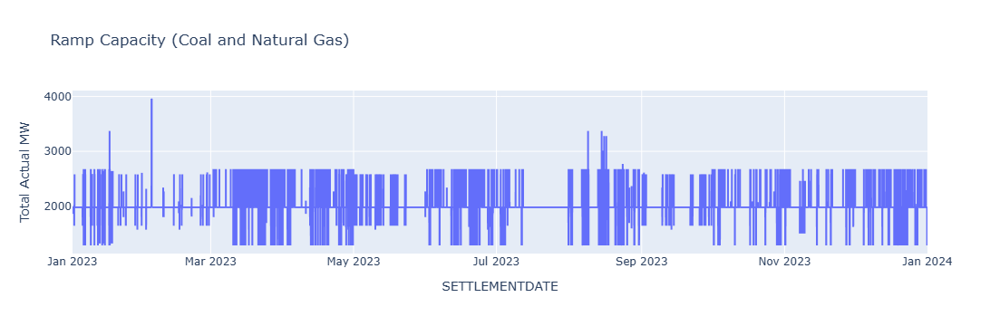

In [10]:
import pandas as pd
import plotly.express as px

# Combine DUID lists for filtering
duids_list = coal_qld + natural_gas_qld

# Filter the load_data dataframe
filtered_df = load_data[load_data['DUID'].isin(duids_list)]

# Calculate 'actual' based on the formula
filtered_df['actual'] = filtered_df['RAMPUPRATE'] - ((filtered_df['TOTALCLEARED'].diff() / 5) * 60)

grouped_df = filtered_df.groupby('SETTLEMENTDATE')['actual'].sum().reset_index()

# Create a plotly line plot for sum of 'actual' vs 'settlement time'
fig = px.line(grouped_df, x='SETTLEMENTDATE', y='actual', title='Ramp Capacity (Coal and Natural Gas)',
              labels={'settlement time': 'SETTLEMENTDATE', 'actual': 'Total Actual MW'})

# Show the plot
fig.show()


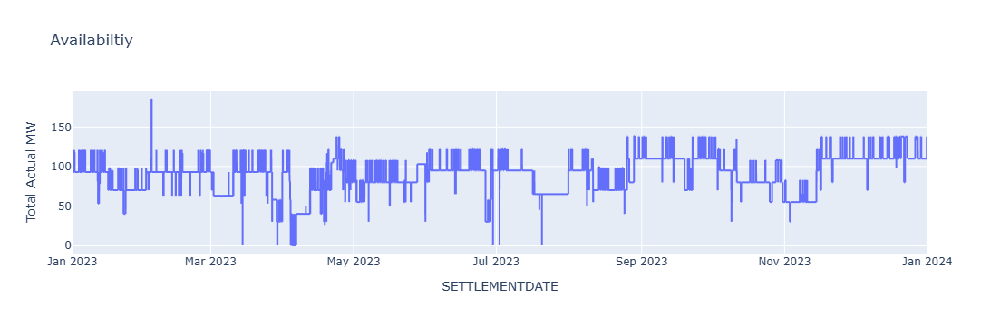

In [11]:
import pandas as pd
import plotly.express as px

# Combine DUID lists for filtering
duids_list = coal_qld + natural_gas_qld

# Filter the load_data dataframe
filtered_df = load_data[load_data['DUID'].isin(duids_list)]

grouped_df = filtered_df.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Create a plotly line plot for sum of 'actual' vs 'settlement time'
fig = px.line(grouped_df, x='SETTLEMENTDATE', y='AVAILABILITY', title="Availabiltiy",
              labels={'settlement time': 'SETTLEMENTDATE', 'AVAILABILITY': 'Total Actual MW'})

# Show the plot
fig.show()


In [12]:
import pandas as pd
import plotly.express as px

# Ensure datetime format with time is preserved
load_data['SETTLEMENTDATE'] = pd.to_datetime(load_data['SETTLEMENTDATE'])
demand_data['SETTLEMENTDATE'] = pd.to_datetime(demand_data['SETTLEMENTDATE'])

# Filter load_data for selected DUIDs
filtered_load = load_data[load_data['DUID'].isin(coal_qld + natural_gas_qld)]

# Sum AVAILABILITY by full datetime
availability_grouped = filtered_load.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Filter demand_data for QLD1 and group by full datetime
qld_demand = demand_data[demand_data['REGIONID'] == 'TAS1']
demand_grouped = qld_demand.groupby('SETTLEMENTDATE')['TOTALDEMAND'].sum().reset_index()

# Merge and calculate gap
merged_df = pd.merge(availability_grouped, demand_grouped, on='SETTLEMENTDATE', how='inner')
merged_df['Availability-Demand Gap'] = merged_df['AVAILABILITY'] - merged_df['TOTALDEMAND']

# Create the line plot with time formatting
fig = px.line(
    merged_df,
    x='SETTLEMENTDATE',
    y='Availability-Demand Gap',
    title="QLD1 Availability - Demand Gap Over Time",
    labels={'SETTLEMENTDATE': 'Settlement Time', 'Availability-Demand Gap': 'MW Gap'}
)

# Force time formatting on x-axis
fig.update_layout(
    xaxis=dict(
        tickformat="%Y-%m-%d %H:%M",  # Customize format to show date + time
        title='Settlement Time',
        tickangle=45
    )
)

fig.show()


In [13]:
import pandas as pd
import plotly.express as px

# Combine DUID lists for filtering
duids_list = coal_qld + natural_gas_qld

# Filter the load_data dataframe
filtered_df = load_data[load_data['DUID'].isin(duids_list)]

# Group by SETTLEMENTDATE and sum availability
grouped_df = filtered_df.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Sort availability in ascending order for this style (so 0 is at the left)
sorted_avail = grouped_df['AVAILABILITY'].sort_values().reset_index(drop=True)

# Calculate the percentage of time the availability was exceeded
percent_exceeded = (1 - sorted_avail.rank(method='first') / len(sorted_avail)) * 100

# Create DataFrame for plotting
duration_df = pd.DataFrame({
    'Availability': sorted_avail,
    'Percent Time Exceeded': percent_exceeded
})

# Create the plot
fig = px.line(duration_df, x='Availability', y='Percent Time Exceeded',
              title='Availability Duration Curve',
              labels={'Availability': 'Total Availability (MW)',
                      'Percent Time Exceeded': 'Percent of Time Availability Was Exceeded (%)'})

fig.show()


In [67]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# --- Assume these DataFrames are pre-loaded ---
# For demonstration, let's create dummy data that mimics your structure.
# In your code, you would use your actual load_data and demand_data.
date_range = pd.to_datetime(pd.date_range(start='2023-01-01', periods=17520, freq='30min'))
load_data = pd.DataFrame({
    'SETTLEMENTDATE': np.repeat(date_range, 2),
    'DUID': ['COAL_GEN', 'GAS_GEN'] * len(date_range),
    'AVAILABILITY': np.random.uniform(2000, 5000, len(date_range) * 2)
})
demand_data = pd.DataFrame({
    'SETTLEMENTDATE': date_range,
    'REGIONID': 'TAS1',
    'TOTALDEMAND': np.random.uniform(6000, 9000, len(date_range))
})
coal_qld = ['COAL_GEN']
natural_gas_qld = ['GAS_GEN']
# --- End of Dummy Data Creation ---


# 1. DATA PREPARATION (Your original logic)
# --------------------------------------------------------------------------
# Combine DUID lists for filtering
duids_list = coal_qld + natural_gas_qld

# Ensure datetime is parsed
load_data['SETTLEMENTDATE'] = pd.to_datetime(load_data['SETTLEMENTDATE'])
demand_data['SETTLEMENTDATE'] = pd.to_datetime(demand_data['SETTLEMENTDATE'])

# Filter load_data for the selected DUIDs (coal + gas)
filtered_load = load_data[load_data['DUID'].isin(duids_list)]

# Group and sum AVAILABILITY by time
availability_grouped = filtered_load.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Filter demand_data for QLD1 and group by time
qld_demand = demand_data[demand_data['REGIONID'] == 'TAS1']
demand_grouped = qld_demand.groupby('SETTLEMENTDATE')['TOTALDEMAND'].sum().reset_index()

# Merge and calculate the gap
merged_df = pd.merge(availability_grouped, demand_grouped, on='SETTLEMENTDATE', how='inner')
merged_df['Gap'] = merged_df['TOTALDEMAND'] - merged_df['AVAILABILITY'] 

# Sort gap values in ascending order
sorted_gap = merged_df['Gap'].sort_values().reset_index(drop=True)

# Calculate percent of time the gap was exceeded
# Using rank(method='first') ensures unique ranks for ties
percent_exceeded = (1 - (sorted_gap.rank(method='first') - 1) / len(sorted_gap)) * 100

# Create DataFrame for plotting
duration_df = pd.DataFrame({
    'Availability-Demand Gap (MW)': sorted_gap,
    'Percent Time Exceeded (%)': percent_exceeded
})


# 2. STYLING AND PLOTTING WITH MATPLOTLIB
# --------------------------------------------------------------------------
# Define colors similar to your desired theme
COLORS = {
    'main_line': '#2E86AB',
    'threshold': '#F24236',
    'background': '#FAFAFA',
    'grid': '#E8E8E8',
    'text': '#2C3E50'
}

# Define threshold value and find its corresponding percentage
threshold_gap = 1520.17         # Example: 1000 MW gap
# Interpolate to find the y-value for our threshold
threshold_percent = np.interp(
    threshold_gap, 
    duration_df['Availability-Demand Gap (MW)'], 
    duration_df['Percent Time Exceeded (%)']
)

# Plot setup
plt.figure(figsize=(12, 7), dpi=300)

# Main duration curve
plt.plot(
    duration_df['Availability-Demand Gap (MW)'], 
    duration_df['Percent Time Exceeded (%)'], 
    color=COLORS['main_line'], 
    linewidth=2.5, 
    label='Gap Duration Curve'
)

# Threshold lines and point
plt.axvline(x=threshold_gap, color=COLORS['threshold'], linestyle='--', linewidth=1.8, label=f'Threshold: {threshold_gap:,.0f} MW')
plt.axhline(y=threshold_percent, color=COLORS['threshold'], linestyle='--', linewidth=1.8)
plt.scatter(threshold_gap, threshold_percent, color=COLORS['threshold'], edgecolors='white', s=100, zorder=5)

# Annotate threshold point
# We add a small offset to the text position for better visibility
text_offset_x = (duration_df['Availability-Demand Gap (MW)'].max() - duration_df['Availability-Demand Gap (MW)'].min()) * 0.02
plt.text(
    threshold_gap + text_offset_x, 
    threshold_percent,
    f"Threshold\n{threshold_gap:,.0f} MW",
    color=COLORS['text'],
    fontsize=10,
    verticalalignment='center', # Align text vertically with the point
    bbox=dict(facecolor='white', edgecolor=COLORS['threshold'], boxstyle='round,pad=0.3')
)

# Axes, grid, and titles
plt.xlabel('Availability - Demand Gap (MW)', fontsize=13, color=COLORS['text'])
plt.ylabel('Percent of Time Gap is Exceeded (%)', fontsize=13, color=COLORS['text'])
plt.title('Availability - Demand Gap Duration Curve', fontsize=16, color=COLORS['text'], weight='bold')
plt.grid(True, color=COLORS['grid'], linestyle='--', linewidth=0.5)

# General styling
plt.gca().set_facecolor(COLORS['background'])
plt.xticks(color=COLORS['text'])
plt.yticks(color=COLORS['text'])
plt.legend(loc='upper right', fontsize=10)

# Save as PNG instantly and free memory
plt.tight_layout()
plt.savefig("availability_demand_gap_curve.png")
plt.close()

print("Graph 'availability_demand_gap_curve.png' has been saved.")

Graph 'availability_demand_gap_curve.png' has been saved.


In [23]:
import pandas as pd
import plotly.express as px

# Combine DUID lists for filtering
duids_list = solar_qld 

# Filter the load_data dataframe
filtered_df = load_data[load_data['DUID'].isin(duids_list)]

# Group by SETTLEMENTDATE and sum availability
grouped_df = filtered_df.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Sort availability in ascending order for this style (so 0 is at the left)
sorted_avail = grouped_df['AVAILABILITY'].sort_values().reset_index(drop=True)

# Calculate the percentage of time the availability was exceeded
percent_exceeded = (1 - sorted_avail.rank(method='first') / len(sorted_avail)) * 100

# Create DataFrame for plotting
duration_df = pd.DataFrame({
    'Availability': sorted_avail,
    'Percent Time Exceeded': percent_exceeded
})

# Create the plot
fig = px.line(duration_df, x='Availability', y='Percent Time Exceeded',
              title='Availability Duration Curve',
              labels={'Availability': 'Total Availability (MW Solar)',
                      'Percent Time Exceeded': 'Percent of Time Availability Was Exceeded (%)'})

fig.show()


In [ ]:
import pandas as pd

# Define the cutoff time
cutoff_time = pd.to_datetime('2023-06-30 00:10:00')

# Step 1: Filter price_data for QLD1 with RRP > 2000 and time before cutoff
unusual_price_df = price_data[
    (price_data['REGIONID'] == 'QLD1') &
    (price_data['RRP'] > 2000) &
    (price_data['SETTLEMENTDATE'] < cutoff_time)
].copy()

# Step 2: Filter demand_data for QLD1
demand_qld = demand_data[demand_data['REGIONID'] == 'QLD1'].copy()

# Step 3: Merge price and demand on SETTLEMENTDATE
price_demand_df = unusual_price_df.merge(demand_qld, on='SETTLEMENTDATE', how='left')

# Step 4: Filter load_data to only selected DUIDs (no region filtering)
selected_duids = coal_qld + natural_gas_qld
filtered_load = load_data[load_data['DUID'].isin(selected_duids)].copy()

# Step 5: Aggregate availability by SETTLEMENTDATE
availability_df = filtered_load.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Step 6: Merge with price+demand
combined_df = price_demand_df.merge(availability_df, on='SETTLEMENTDATE', how='left')

# Step 7: Sort by RRP descending (optional)
combined_df = combined_df.sort_values(by='SETTLEMENTDATE')

# Show the final result
print(combined_df[['SETTLEMENTDATE', 'RRP', 'TOTALDEMAND', 'AVAILABILITY']])


In [ ]:
import pandas as pd

# Define the cutoff time
cutoff_time = pd.to_datetime('2023-06-30 00:10:00')

# Step 1: Filter price_data for QLD1 with RRP > 2000 and time before cutoff
unusual_price_df = price_data[
    (price_data['REGIONID'] == 'QLD1') &
    (price_data['RRP'] > 2000) &
    (price_data['SETTLEMENTDATE'] < cutoff_time)
].copy()

# Step 2: Get timestamps before and after each unusual price point
time_offsets = pd.Timedelta('5min')  # Assuming 5-minute intervals
surrounding_times = []

for ts in unusual_price_df['SETTLEMENTDATE']:
    surrounding_times.extend([ts - time_offsets, ts, ts + time_offsets])

# Step 3: Remove duplicates
surrounding_times = sorted(set(surrounding_times))

# Step 4: Filter original datasets by surrounding_times and QLD1 region
price_subset = price_data[
    (price_data['SETTLEMENTDATE'].isin(surrounding_times)) &
    (price_data['REGIONID'] == 'QLD1')
].copy()

demand_subset = demand_data[
    (demand_data['SETTLEMENTDATE'].isin(surrounding_times)) &
    (demand_data['REGIONID'] == 'QLD1')
].copy()

# Step 5: Merge price and demand
price_demand_df = price_subset.merge(demand_subset, on='SETTLEMENTDATE', how='left')

# Step 6: Filter and aggregate load data
selected_duids = coal_qld + natural_gas_qld
filtered_load = load_data[
    (load_data['DUID'].isin(selected_duids)) &
    (load_data['SETTLEMENTDATE'].isin(surrounding_times))
].copy()

availability_df = filtered_load.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Step 7: Merge all together
combined_df = price_demand_df.merge(availability_df, on='SETTLEMENTDATE', how='left')

# Step 8: Sort and show results
combined_df = combined_df.sort_values(by='SETTLEMENTDATE')

# Show the result
print(combined_df[['SETTLEMENTDATE', 'RRP', 'TOTALDEMAND', 'AVAILABILITY']])



In [ ]:
combined_df[['SETTLEMENTDATE', 'RRP', 'TOTALDEMAND', 'AVAILABILITY']].to_csv('unusual_price_context.csv', index=False)


In [ ]:
print(price_data['PRICE_STATUS'].unique())


In [ ]:
df_nsw = pd.read_excel(file_name, sheet_name="NSW1")

# Drop NaN values and convert to a list
natural_gas_nsw = df_nsw["Natural Gas DUID"].dropna().tolist()
coal_nsw = df_nsw["Coal DUID"].dropna().tolist()
solar_nsw = df_nsw["Solar DUID"].dropna().tolist()
wind_nsw = df_nsw["Wind DUID"].dropna().tolist()

In [ ]:
import pandas as pd

# Define the cutoff time
cutoff_time = pd.to_datetime('2023-06-30 00:10:00')

# Step 1: Filter price_data for QLD1 with RRP > 2000 and time before cutoff
unusual_price_df = price_data[
    (price_data['REGIONID'] == 'NSW1') &
    (price_data['RRP'] > 2000) &
    (price_data['SETTLEMENTDATE'] < cutoff_time)
].copy()

# Step 2: Get timestamps before and after each unusual price point
time_offsets = pd.Timedelta('5min')  # Assuming 5-minute intervals
surrounding_times = []

for ts in unusual_price_df['SETTLEMENTDATE']:
    surrounding_times.extend([ts - time_offsets, ts, ts + time_offsets])

# Step 3: Remove duplicates
surrounding_times = sorted(set(surrounding_times))

# Step 4: Filter original datasets by surrounding_times and QLD1 region
price_subset = price_data[
    (price_data['SETTLEMENTDATE'].isin(surrounding_times)) &
    (price_data['REGIONID'] == 'NSW1')
].copy()

demand_subset = demand_data[
    (demand_data['SETTLEMENTDATE'].isin(surrounding_times)) &
    (demand_data['REGIONID'] == 'NSW1')
].copy()

# Step 5: Merge price and demand
price_demand_df = price_subset.merge(demand_subset, on='SETTLEMENTDATE', how='left')

# Step 6: Filter and aggregate load data
selected_duids = coal_nsw + natural_gas_nsw
filtered_load = load_data[
    (load_data['DUID'].isin(selected_duids)) &
    (load_data['SETTLEMENTDATE'].isin(surrounding_times))
].copy()

availability_df = filtered_load.groupby('SETTLEMENTDATE')['AVAILABILITY'].sum().reset_index()

# Step 7: Merge all together
combined_df = price_demand_df.merge(availability_df, on='SETTLEMENTDATE', how='left')

# Step 8: Sort and show results
combined_df = combined_df.sort_values(by='SETTLEMENTDATE')

# Show the result
print(combined_df[['SETTLEMENTDATE', 'RRP', 'TOTALDEMAND', 'AVAILABILITY']])

